## Analyze population by race in the top 10 US states

In [3]:
# Standard imports
import os


# Geospatial imports
import fiona
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import descartes
%matplotlib inline

## Load data

In [4]:
fiona.listlayers("../data/UnitedStates.gdb")

['COStreets2',
 'COStreets1',
 'HHWZIPCodes',
 'PAPublicSchools',
 'PACounties',
 'CACounties',
 'USCities_dtl',
 'PATracts',
 'PAZIP',
 'PACities',
 'USStates',
 'USCities',
 'CAOrangeCountyTracts',
 'Congress111',
 'MilitaryBnd',
 'MilitaryPt',
 'USCounties',
 'COCounties',
 'COUrban1',
 'COUrban2',
 'COWater1',
 'COWater2',
 'COStreets']

In [5]:
usstates = gpd.read_file("../data/UnitedStates.gdb/", driver="FileGDB", layer="USStates")

In [6]:
usstates.columns

Index(['STATE_NAME', 'STATE_FIPS', 'SUB_REGION', 'STATE_ABBR', 'POP2000',
       'POP00_SQMI', 'HSE_UNITS_00', 'VACANT_00', 'OWNER_OCC_00',
       'RENTER_OCC_00', 'POP_2010', 'POP10_SQMI', 'POP_CHANGE', 'REGION10',
       'DIVISION10', 'STATEFP10', 'STATENS10', 'GEOID10', 'STUSPS10', 'NAME10',
       'LSAD10', 'MTFCC10', 'FUNCSTAT10', 'ALAND10', 'AWATER10', 'INTPTLAT10',
       'INTPTLON10', 'MALES', 'FEMALES', 'AGE_UNDER5', 'AGE_5_9', 'AGE_10_14',
       'AGE_15_19', 'AGE_20_24', 'AGE_25_29', 'AGE_30_34', 'AGE_35_39',
       'AGE_40_44', 'AGE_45_49', 'AGE_50_54', 'AGE_55_59', 'AGE_60_64',
       'AGE_65_69', 'AGE_70_74', 'AGE_75_79', 'AGE_80_84', 'AGE_85_89',
       'AGE_90_UP', 'AGE_UNDER1', 'AGE_18_64', 'AGE_65_UP', 'MED_AGE',
       'MED_AGE_M', 'MED_AGE_F', 'WHITE', 'BLACK', 'AMERI_ES', 'ASIAN',
       'HAW_PI', 'OTHER', 'HISPANIC', 'HSE_UNITS', 'VACANT', 'OCCUPIED',
       'OWNER_OCC', 'RENTER_OCC', 'Shape_Length', 'Shape_Area',
       'HSE_UNITS_CHANGE', 'VACANT_CHANGE', 'OWN_O

## Projections
Determine current projection, then set projection to North American Albers Equal Conic Area 

In [7]:
usstates.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Per spatialreference.org, the North American Albers Equal Conic Area projection is ESPG:102008.
https://spatialreference.org/ref/esri/north-america-albers-equal-area-conic/

Re-project to ESRI:102008

In [8]:
usstates = usstates.to_crs("ESRI:102008")
usstates.crs

<Projected CRS: ESRI:102008>
Name: North_America_Albers_Equal_Area_Conic
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - Canada and USA (CONUS, Alaska mainland)
- bounds: (-172.54, 23.81, -47.74, 86.46)
Coordinate Operation:
- name: North_America_Albers_Equal_Area_Conic
- method: Albers Equal Area
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

## Requirements

Symbolize the layer with a hollow fill and medium-gray outline (30%)

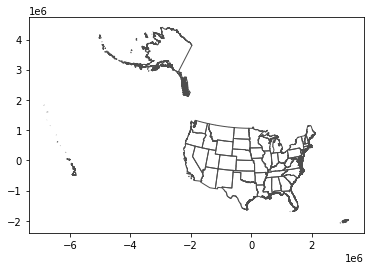

In [9]:
fig, ax = plt.subplots(1,1)
usstates.plot(ax=ax, color="none", edgecolor='.3', figsize=(200,200))

Zoom to the 48 contiguous states and create a spatial bookmark
Note: No bookmark is created in Python

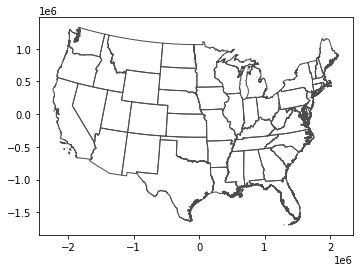

In [10]:
conus_usstates = usstates[(usstates["STATE_ABBR"] != "AK") & (usstates["STATE_ABBR"] != "HI") & (usstates["STATE_ABBR"] != "PR")]

fig, ax = plt.subplots(1,1)
conus_usstates.plot(ax=ax, color="none", edgecolor='.3', figsize=(200,200))

Label states with their two-letter abbreviation using a yellow-halo mask label.

In [11]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1)

Change selection color to Mars Red and use the USStates attribute to select the 10 US states and territories having the highest population in 2010.

In [12]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "POP_2010").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

Export and save map as Assignment_1-1.jpg

In [13]:
fig.savefig('Assignment_1.1.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

##Using USStates attribute table, select the top 10 states and territories in year 2010 by populuation to generate:
* Population by Race
**White
**Black
**American Indian/Eskimo
**Asian
**Hawaiian-Pacific Islander
**Other
**Total

### Population of Whites

In [14]:
top10 = conus_usstates.nlargest(10, "POP_2010")[["WHITE", "BLACK", 'AMERI_ES', 'ASIAN', 'HAW_PI', 'OTHER']].sum()
tot = conus_usstates[["WHITE", "BLACK", 'AMERI_ES', 'ASIAN', 'HAW_PI', 'OTHER']].sum()
top10_to_tot = top10 / tot

In [15]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "WHITE").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

In [16]:
fig.savefig('Assignment_1.1_white.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

In [17]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "BLACK").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

In [18]:
fig.savefig('Assignment_1.1_black.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

In [19]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "AMERI_ES").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

In [20]:
fig.savefig('Assignment_1.1_ameries.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

In [21]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "ASIAN").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

In [22]:
fig.savefig('Assignment_1.1_asian.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

In [23]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "HAW_PI").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

In [24]:
fig.savefig('Assignment_1.1_hawpi.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

In [25]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
conus_usstates.nlargest(10, "OTHER").plot(ax=ax, color="red", alpha=0.3)
conus_usstates.plot(ax=ax, color="none", edgecolor='.4')
conus_usstates.apply(lambda x: ax.annotate(s=x.STATE_ABBR, xy=x.geometry.centroid.coords[0], ha='center', size=150, bbox={'facecolor': 'yellow', 'alpha':0.8, 'pad': 4, 'edgecolor':'none'}), axis=1);

In [26]:
fig.savefig('Assignment_1.1_other.png', format='png', transparent=True, dpi=150, bbox_inches='tight')

## Get Statistics

Using the USStates attribute table, select the top 10 states and territories in year 2010 by population to generate summary statistics according to the following table:



| Race                    |    Pop by race: 10 most populous state | Pop by race: All states | Percent of pop by race of 10 most populous states |
| ------------------------- | ---------------------- | ---------------------- | ---------------------- | 
| White | | | |
| Black
| American Indian / Eskimo
| Asian
| Hawaiian-Pacific Islander
| Other
| Total

In [41]:
top10 = usstates.nlargest(10, "POP_2010")[["WHITE", "BLACK", 'AMERI_ES', 'ASIAN', 'HAW_PI', 'OTHER', 'POP_2010']].sum()
tot = usstates[["WHITE", "BLACK", 'AMERI_ES', 'ASIAN', 'HAW_PI', 'OTHER', 'POP_2010']].sum()
top10_to_tot = top10 / tot
totals = pd.DataFrame([top10, tot, top10_to_tot], columns=["WHITE", "BLACK", 'AMERI_ES', 'ASIAN', 'HAW_PI', 'OTHER', 'POP_2010'])
totals = totals.T
totals.columns = ["PopbyRace_Top10States", "PopbyRace_All", "PctofTotal"]
totals


,PopbyRace_Top10States,PopbyRace_All,PctofTotal
WHITE,115248734.0,226378365.0,0.509098
BLACK,22403541.0,39390817.0,0.568750
AMERI_ES,1024503.0,2952087.0,0.347044
ASIAN,9590551.0,14681083.0,0.653259
HAW_PI,214870.0,540383.0,0.397625
OTHER,13310621.0,19397273.0,0.686211
POP_2010,166755220.0,312471327.0,0.533666
